In [1]:
import librosa
import matplotlib.pyplot as plt
import librosa.display
from IPython.display import Audio
import numpy as np
import glob
import os
import pandas as pd

from tqdm import tqdm
import seaborn as sns

In [2]:
files_ann = os.listdir('../../Grabaciones curadas/Annotaciones')
real_files = filter(lambda x: not (x.startswith('.') or x.startswith('desk')) , files_ann)
df = pd.DataFrame()

In [3]:
for path in real_files:
    df_path = pd.read_csv(f'../../Grabaciones curadas/Annotaciones/{path}', sep='\t', header=None)
    df_path['file'] = path
    df = pd.concat([df_path, df ])

df.rename({0: 'init', 1: 'end', 2:'label'}, axis=1, inplace=True)
df.reset_index(drop=True, inplace=True)
df = df.loc[~df.label.str.contains('VOICE')]
df.insert(2, 'length', df.end - df.init)
df.insert(3, 'rana_label', df.label.str.extract('(\w+)_\w')[0])
df.insert(4, 'quality_label', df.label.str.extract('\w+_(\w)')[0])
df['is_def'] = ~df['rana_label'].str.startswith('UN')

In [4]:
# Datos ppt
print('Cantidad de grabaciones únicas:: ',df.file.nunique())
print('Anotaciones promedio por grabación:: ',df.groupby('file').size().mean())
print('Anotaciones totales:: ',df.groupby('file').size().sum())
print('Anotaciones promedio por grabación con categoría definida:: ',df.loc[df.rana_label != 'UND'].groupby('file').size().mean())
print('Anotaciones totales con categoría definida:: ',df.loc[df.rana_label != 'UND'].groupby('file').size().sum())


Cantidad de grabaciones únicas::  270
Anotaciones promedio por grabación::  16.22962962962963
Anotaciones totales::  4382
Anotaciones promedio por grabación con categoría definida::  12.25925925925926
Anotaciones totales con categoría definida::  3310


In [5]:
# df.rana_label.value_counts(normalize=True).plot.pie(figsize=(10, 10))

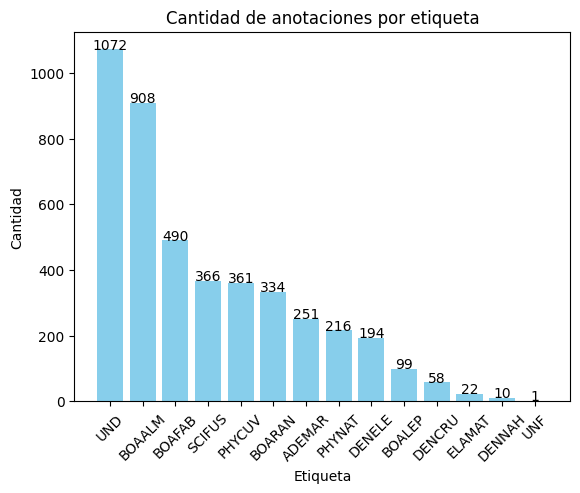

In [6]:
temp_1 = df.rana_label.value_counts()
# Sample data
categories = temp_1.index
values = temp_1.values
# Create bar plot
plt.bar(categories, values, color='skyblue')

# Add values on top of the bars
for i, value in enumerate(values):
    plt.text(i, value + 1, str(value), ha='center')

# Add labels and title
plt.xlabel('Etiqueta')
plt.ylabel('Cantidad')
plt.title('Cantidad de anotaciones por etiqueta')
plt.xticks(rotation=45)

# Show plot
plt.show()

In [7]:
# calidad en etiquetas definidas y no definidas
pd.crosstab(df.is_def, df.quality_label, normalize='index')

quality_label,C,F,M
is_def,,,
False,0.005592,0.440820,0.553588
True,0.463886,0.107283,0.428830


In [8]:
pd.crosstab(df.rana_label, df.quality_label).loc[temp_1.index].T

rana_label,UND,BOAALM,BOAFAB,SCIFUS,PHYCUV,BOARAN,ADEMAR,PHYNAT,DENELE,BOALEP,DENCRU,ELAMAT,DENNAH,UNF
quality_label,,,,,,,,,,,,,,
C,6,290,171,189,251,83,212,128,90,58,57,0,6,0
F,472,33,62,65,49,59,22,22,40,0,0,3,0,1
M,594,585,257,112,61,192,17,66,64,41,1,19,4,0


<Axes: xlabel='rana_label'>

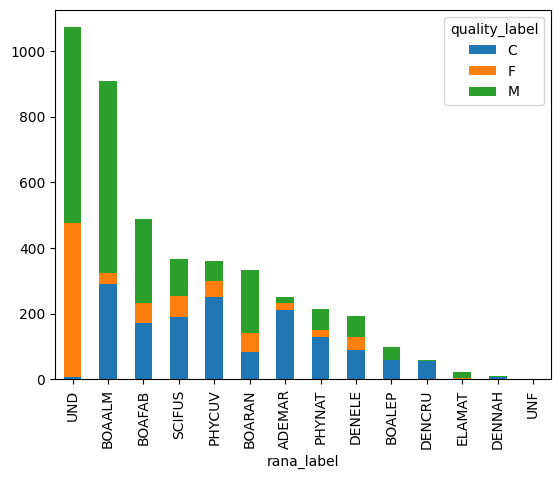

In [9]:
pd.crosstab(df.rana_label, df.quality_label).loc[temp_1.index].plot(kind='bar', stacked=True)

In [10]:
print('Minutos de grabaciones totales:: ', df['length'].sum() / 60)
print('Segundos promedio de anotación:: ', df['length'].mean())
print('Minutos de grabaciones con etiqueta definida:: ',df.loc[df.rana_label != 'UND', 'length'].sum() / 60)
print('Segundos promedio de anotación con etiqueta definida:: ',df.loc[df.rana_label != 'UND', 'length'].mean())

Minutos de grabaciones totales::  475.34106004999995
Segundos promedio de anotación::  6.5085494301688716
Minutos de grabaciones con etiqueta definida::  308.56106983333336
Segundos promedio de anotación con etiqueta definida::  5.593252021148037


In [11]:
df

,init,end,length,rana_label,quality_label,label,file,is_def
0,1.037451,7.153585,6.116134,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
1,13.595430,15.296367,1.700937,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
2,17.057621,26.261980,9.204359,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
3,22.317255,24.223269,1.906014,UND,F,UND_F,TASCAM_0053-LARISSA.txt,False
4,28.421325,33.017473,4.596148,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
...,...,...,...,...,...,...,...,...
4589,115.158749,115.190109,0.031360,DENCRU,C,DENCRU_C,1577-D.cruzi.txt,True
4590,116.314727,118.668856,2.354129,DENCRU,C,DENCRU_C,1577-D.cruzi.txt,True
4591,119.698314,121.039205,1.340891,DENCRU,C,DENCRU_C,1577-D.cruzi.txt,True
4592,122.124894,136.468103,14.343209,DENCRU,C,DENCRU_C,1577-D.cruzi.txt,True


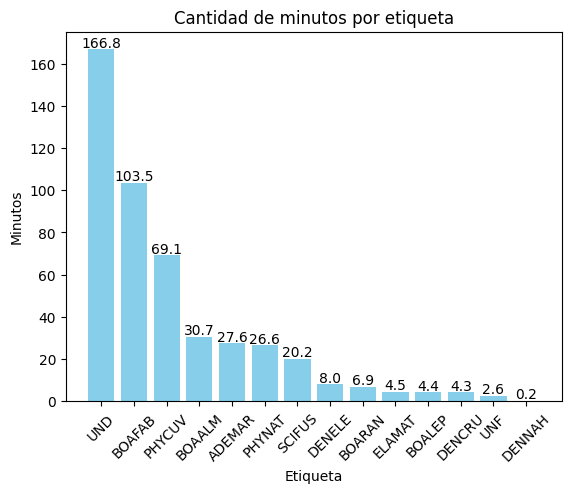

In [12]:
# Cantidad de minutos por etiqueta
temp_2 = (df.groupby('rana_label')['length'].sum() / 60).sort_values(ascending=False)
# Sample data
categories = temp_2.index
values = temp_2.values.round(1)
# Create bar plot
plt.bar(categories, values, color='skyblue')

# Add values on top of the bars
for i, value in enumerate(values):
    plt.text(i, value + 1, str(value), ha='center')

# Add labels and title
plt.xlabel('Etiqueta')
plt.ylabel('Minutos')
plt.title('Cantidad de minutos por etiqueta')
plt.xticks(rotation=45)

# Show plot
plt.show()

In [13]:
(pd.pivot_table(df, 'length', 'rana_label', 'quality_label', aggfunc='sum') / 60).loc[temp_2.index].T

rana_label,UND,BOAFAB,PHYCUV,BOAALM,ADEMAR,PHYNAT,SCIFUS,DENELE,BOARAN,ELAMAT,BOALEP,DENCRU,UNF,DENNAH
quality_label,,,,,,,,,,,,,,
C,0.024163,24.818131,27.568683,2.290977,16.294820,7.940895,2.939306,0.856396,2.235113,NaN,2.680197,4.236305,NaN,0.073323
F,65.494978,25.727806,24.496784,11.302054,8.363217,9.438363,13.072365,4.120330,1.703830,0.087627,NaN,NaN,2.609586,NaN
M,101.260849,52.930381,17.045730,17.105311,2.922933,9.223597,4.228770,3.067460,2.947963,4.414632,1.696476,0.030166,NaN,0.091542


In [14]:
pd.pivot_table(df, 'length', 'is_def', 'quality_label', aggfunc='sum') / 60

quality_label,C,F,M
is_def,,,
False,0.024163,68.104565,101.260849
True,91.934146,98.312376,115.704961


<Axes: xlabel='rana_label'>

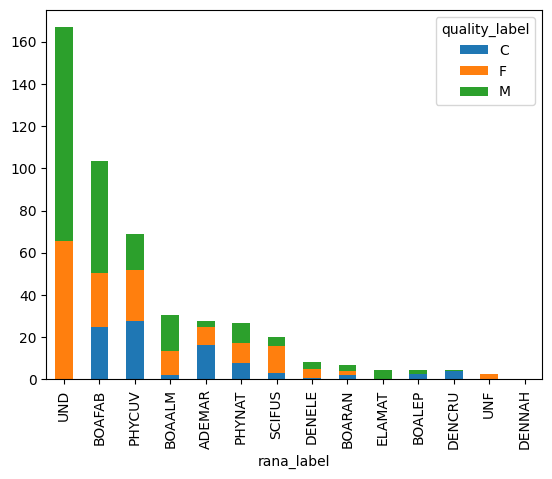

In [15]:
(pd.pivot_table(df, 'length', 'rana_label', 'quality_label', aggfunc='sum') / 60).loc[temp_2.index].plot(kind='bar', stacked=True)

In [16]:
files_wav = os.listdir('../../Grabaciones curadas/Grabaciones curadas')
# files_wav = [i for i in files_wav if i[-4:] != '.txt']
files_wav = pd.Series(files_wav)

In [17]:
def character_score(t_1, t_2):
    max_len = min(len(t_1), len(t_2))
    score = 0
    for i in range(max_len):
        if t_1[i] == t_2[i]:
            score += 1
        else:
            break

    return score

In [18]:
def get_wav_path(name_file):
    idx = files_wav.apply(lambda x: character_score(name_file, x)).idxmax()
    return files_wav.iloc[idx]

In [19]:
def compose(txt_file):
    name_file, _ = os.path.splitext(txt_file)
    wav_path = get_wav_path(name_file)
    wav_path = '' if wav_path[-4:] == '.txt' else wav_path
    return wav_path

In [20]:
df['file_wav'] = df.file.apply(compose)
df = df.query("file_wav != ''")
df.to_csv('../../Grabaciones curadas/data_catalog.csv', index=False)

In [49]:
df = df.query("file_wav != ''").file.unique()

In [ ]:
df.loc[df.quality_label == 'C']

,init,end,length,rana_label,quality_label,label,file,is_def
77,0.985377,105.435355,104.449978,BOAFAB,C,BOAFAB_C,FNJV_0051350_Boana_faber_Cananeia_SP_Simone De...,True
81,1.392717,34.800565,33.407848,ADEMAR,C,ADEMAR_C,FNJV_0050786_Adenomera_marmorata_Sao Luiz do P...,True
84,1.211422,90.547244,89.335822,ADEMAR,C,ADEMAR_C,FNJV_0050784_Adenomera_marmorata_PARNA da Tiju...,True
94,2.368922,14.971389,12.602467,ADEMAR,C,ADEMAR_C,FNJV_0050766_Adenomera_marmorata_PARNA do Itat...,True
95,31.649205,34.540093,2.890888,ADEMAR,C,ADEMAR_C,FNJV_0050766_Adenomera_marmorata_PARNA do Itat...,True
...,...,...,...,...,...,...,...,...
4567,126.977159,133.197815,6.220656,DENCRU,C,DENCRU_C,1580-D.cruzi.txt,True
4570,135.045586,136.363939,1.318353,DENCRU,C,DENCRU_C,1580-D.cruzi.txt,True
4571,141.338907,149.108888,7.769981,DENCRU,C,DENCRU_C,1580-D.cruzi.txt,True
4572,150.349386,154.626249,4.276863,DENCRU,C,DENCRU_C,1580-D.cruzi.txt,True


In [ ]:
df.loc[df.rana_label == 'BOAFAB']


,init,end,length,rana_label,quality_label,label,file,is_def
33,1.480149,34.927910,33.447761,BOAFAB,M,BOAFAB_M,FNJV_0051353_Boana_faber_Cananeia_SP_Simone De...,True
40,36.453186,129.260343,92.807157,BOAFAB,M,BOAFAB_M,FNJV_0051353_Boana_faber_Cananeia_SP_Simone De...,True
57,1.328709,259.840683,258.511974,BOAFAB,F,BOAFAB_F,FNJV_0051352_Boana_faber_Cananeia_SP_Simone De...,True
74,261.061923,310.556316,49.494393,BOAFAB,M,BOAFAB_M,FNJV_0051352_Boana_faber_Cananeia_SP_Simone De...,True
77,0.985377,105.435355,104.449978,BOAFAB,C,BOAFAB_C,FNJV_0051350_Boana_faber_Cananeia_SP_Simone De...,True
...,...,...,...,...,...,...,...,...
4264,18.523437,21.581112,3.057675,BOAFAB,C,BOAFAB_C,FNJV_0011068_Boana_faber_Campinas_SP_Marcio R....,True
4268,0.980509,51.552406,50.571897,BOAFAB,C,BOAFAB_C,FNJV_0011067_Boana_faber_Campinas_SP_Marcio R....,True
4272,17.012251,37.776217,20.763966,BOAFAB,M,BOAFAB_M,FNJV_0010324_Boana_faber_Anhembi_SP_Jose Carlo...,True
4276,39.167827,183.152026,143.984199,BOAFAB,M,BOAFAB_M,FNJV_0010324_Boana_faber_Anhembi_SP_Jose Carlo...,True


In [ ]:
df

,init,end,length,rana_label,quality_label,label,file,is_def
0,1.037451,7.153585,6.116134,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
1,13.595430,15.296367,1.700937,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
2,17.057621,26.261980,9.204359,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
3,22.317255,24.223269,1.906014,UND,F,UND_F,TASCAM_0053-LARISSA.txt,False
4,28.421325,33.017473,4.596148,ELAMAT,M,ELAMAT_M,TASCAM_0053-LARISSA.txt,True
...,...,...,...,...,...,...,...,...
4572,150.349386,154.626249,4.276863,DENCRU,C,DENCRU_C,1580-D.cruzi.txt,True
4573,153.057885,153.964815,0.906930,UND,F,UND_F,1580-D.cruzi.txt,False
4574,156.977485,161.311443,4.333958,DENCRU,C,DENCRU_C,1580-D.cruzi.txt,True
4575,158.412110,159.766082,1.353972,UND,F,UND_F,1580-D.cruzi.txt,False


FNJV_0051352_Boana_faber_Cananeia_SP_Simone Dena.txt
FNJV_0051352_Boana_faber_Cananeia_SP_Simone Dena.wav


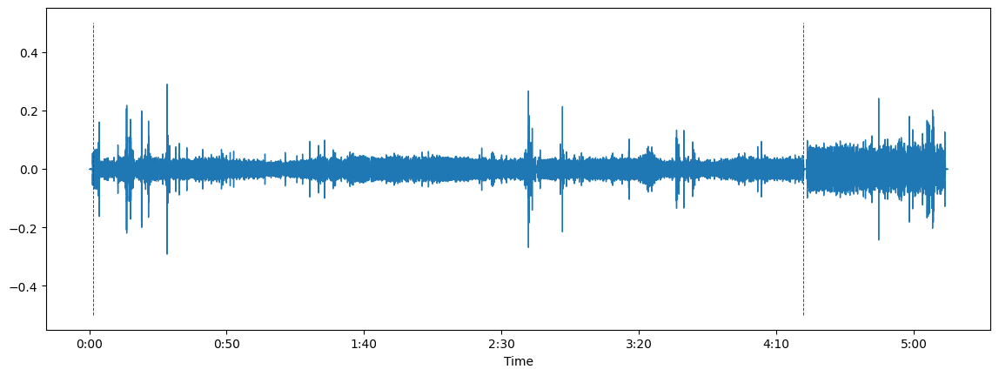

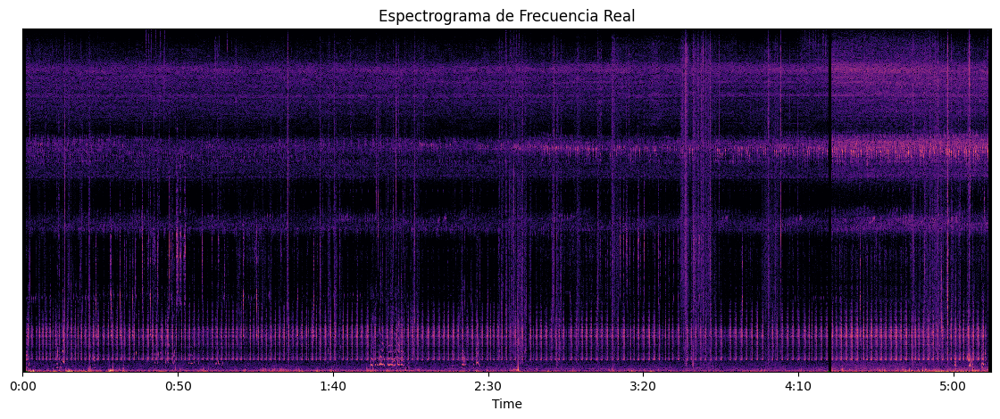

Audio Real: --------------------


In [ ]:
obs = df.loc[57]
txt_file = obs.file
name_file, _ = os.path.splitext(txt_file)
print(txt_file)
wav_path = get_wav_path(name_file)
print(wav_path)
audio, sr = librosa.load(f'./Grabaciones curadas/Grabaciones curadas/{wav_path}')

# waveform
plt.figure().set_figwidth(14)
max_min = 0.5
plt.vlines(x=obs.init, ymin=-max_min, ymax=max_min, colors='green', linestyles='dashed', linewidth=0.7)
plt.vlines(x=obs.end, ymin=-max_min, ymax=max_min, colors='green', linestyles='dashed', linewidth=0.7)
librosa.display.waveshow(audio, sr=sr)

## Espectograma
D = librosa.stft(audio)
# Convert the complex-valued result to magnitude
S_db = librosa.amplitude_to_db(abs(D), ref=np.max)
# Display the spectrogram
plt.figure(figsize=(14, 5))
librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='log')
max_min = 8000
plt.vlines(x=obs.init, ymin=0, ymax=max_min, colors='green', linestyles='dashed', linewidth=1.7)
plt.vlines(x=obs.end, ymin=0, ymax=max_min, colors='green', linestyles='dashed', linewidth=1.7)
# plt.colorbar(format='%+2.0f dB')
plt.title('Espectrograma de Frecuencia Real')
plt.show()

print('Audio Real: --------------------')
Audio(data=audio, rate=sr)


In [ ]:
print('Audio cortado: --------------------')
slice_1 = int(obs.init * sr)
slice_2 = int(obs.end * sr)
Audio(data=audio[slice_1:slice_2], rate=sr)


Audio cortado: --------------------
